https://towardsdatascience.com/getting-to-know-the-mel-spectrogram-31bca3e2d9d0#:~:text=Compute%20FFT%20(Fast%20Fourier%20Transform,n_mels%3D128%20evenly%20spaced%20frequencies.

In [9]:
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Audio

In [17]:
filename = '../00-07-52_dur=600secs.wav'

y, sr = librosa.load(filename)
# trim silent edges
audio, _ = librosa.effects.trim(y)
Audio(data=audio, rate=sr)

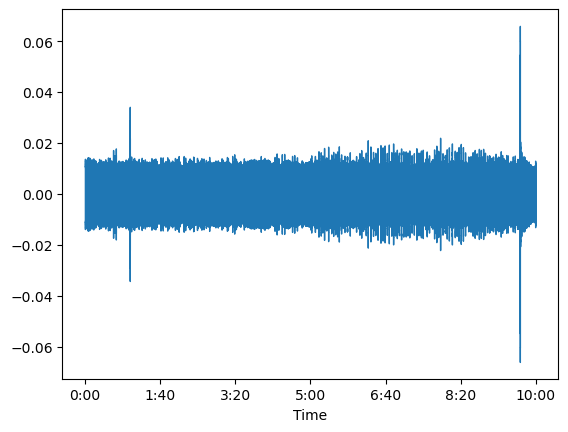

In [11]:
librosa.display.waveshow(audio, sr=sr);

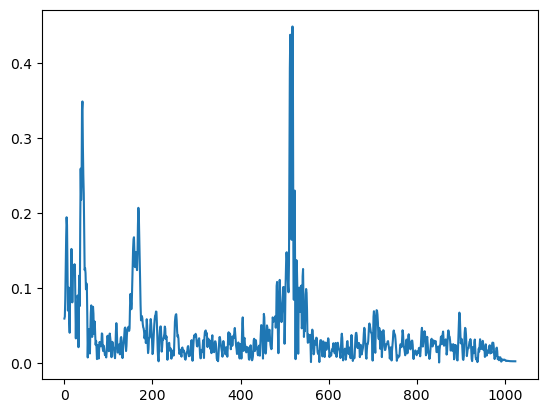

In [12]:
n_fft = 2048
D = np.abs(librosa.stft(audio[:n_fft], n_fft=n_fft, hop_length=n_fft+1))
plt.plot(D);

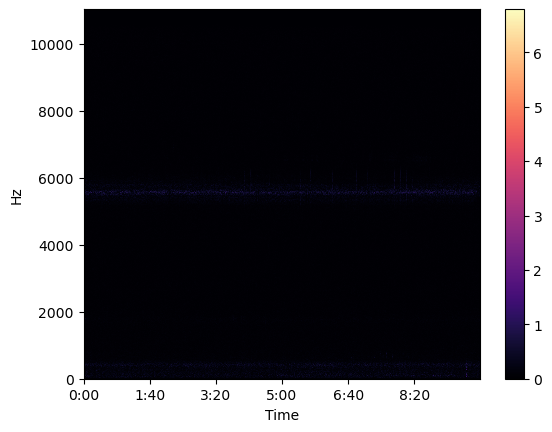

In [13]:
hop_length = 512
D = np.abs(librosa.stft(audio, n_fft=n_fft, hop_length=hop_length))
librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='linear');
plt.colorbar();

time_taken: 9.217706203460693


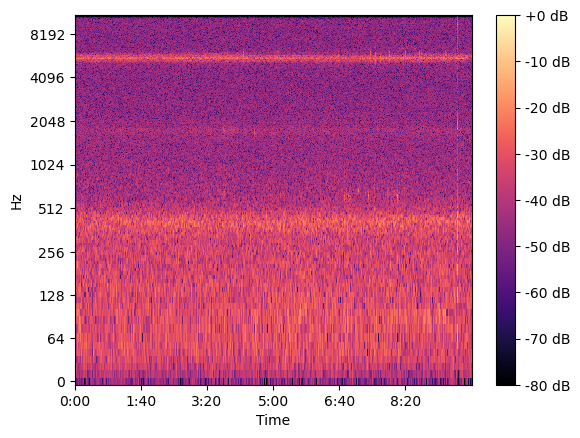

In [19]:
import time

start= time.time()

n_fft = 2048
D = np.abs(librosa.stft(audio[:n_fft], n_fft=n_fft, hop_length=n_fft+1))

hop_length = 512
D = np.abs(librosa.stft(audio, n_fft=n_fft, hop_length=hop_length))

DB = librosa.amplitude_to_db(D, ref=np.max)
librosa.display.specshow(DB, sr=sr, hop_length=hop_length, x_axis='time', y_axis='log');

end = time.time()

print(f'time_taken: {end-start}')
plt.colorbar(format='%+2.0f dB');

In [11]:
import librosa
import numpy as np
import os
import time
from tqdm import tqdm

class Config:
    def __init__(self):
        self.n_mels = 128
        self.fmin = 20
        self.fmax = 16000
        self.n_fft = 2048
        self.hop_length = 512
        self.sample_rate = 32000
        self.secondary_coef = 0.0

def process_audio_file(input_path, output_path, cfg):
    """Process a single audio file and save as .npy"""
    start_time = time.time()
    
    # Load audio file
    audio, _ = librosa.load(input_path, sr=cfg.sample_rate)
    
    # Compute mel spectrogram
    mel_spec = librosa.feature.melspectrogram(
        y=audio,
        sr=cfg.sample_rate,
        n_mels=cfg.n_mels,
        fmin=cfg.fmin,
        fmax=cfg.fmax,
        n_fft=cfg.n_fft,
        hop_length=cfg.hop_length
    )
    
    # Convert to log scale
    log_mel_spec = librosa.power_to_db(mel_spec, top_db=80.0)
    
    # Save as numpy array
    os.makedirs(os.path.dirname(output_path), exist_ok=True)
    np.save(output_path, log_mel_spec)
    
    end_time = time.time()
    return end_time - start_time

def process_directory(input_dir, output_dir, cfg):
    """Process all WAV files in a directory and its subdirectories"""
    total_files = sum([len(files) for _, _, files in os.walk(input_dir)])
    processed_files = 0
    total_time = 0
    
    print(f"Found {total_files} WAV files to process.")
    
    with tqdm(total=total_files, desc="Processing files") as pbar:
        for root, _, files in os.walk(input_dir):
            for filename in files:
                if filename.endswith('.wav'):
                    input_path = os.path.join(root, filename)
                    
                    # Create equivalent output path, but with .npy extension
                    rel_path = os.path.relpath(root, input_dir)
                    output_rel_dir = os.path.join(output_dir, rel_path)
                    output_path = os.path.join(output_rel_dir, filename.replace('.wav', '.npy'))
                    
                    # Process the file
                    processing_time = process_audio_file(input_path, output_path, cfg)
                    total_time += processing_time
                    processed_files += 1
                    pbar.update(1)
    
    print(f"\nProcessing complete!")
    print(f"Total processing time: {total_time:.2f} seconds")
    print(f"Average time per file: {total_time / processed_files:.2f} seconds")
    print(f"Processed {processed_files} files")

if __name__ == "__main__":
    # Initialize configuration
    cfg = Config()
    

    input_directory = "sample_audio"
    output_directory = "npy_output"
    
    process_directory(input_directory, output_directory, cfg)

Found 2 WAV files to process.


Processing files: 100%|██████████| 2/2 [00:01<00:00,  1.07it/s]


Processing complete!
Total processing time: 1.85 seconds
Average time per file: 0.93 seconds
Processed 2 files


In [6]:
result = np.load('npy_output/00-07-52_dur=600secs.npy')
print(f'result: {result}')
print(f'result.shape: {result.shape}')
print(f'result.type: {type(result)}')

result: [[-32.243324 -25.16839  -27.489616 ... -27.560928 -33.32921  -37.541115]
 [-32.160763 -28.954922 -28.829533 ... -36.774815 -36.74343  -34.55328 ]
 [-36.5103   -32.98879  -31.744678 ... -32.47596  -33.805546 -33.27869 ]
 ...
 [-46.80775  -43.158417 -42.072117 ... -42.370693 -42.00136  -43.268322]
 [-44.2919   -39.44065  -37.75973  ... -37.87074  -38.15069  -41.029083]
 [-48.958424 -45.13795  -44.513767 ... -42.33483  -43.04003  -46.70923 ]]
result.shape: (128, 37501)
result.type: <class 'numpy.ndarray'>


In [10]:
result.size * result.itemsize

19200512